In [2]:
import os
import copy
import pymongo
import random
import cv2
import urllib.request
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

#### pattern 中文 (資料庫中會有 17 種 pattern，後來評估其中 5 種是不必要的 pattern，因此才刪去的。請以下面 12 種為準即可)
* 'abstract' : 抽象
* 'animal print' : 動物印花
* 'camouflage':偽裝
* 'floral':花的
* 'geometric':幾何
* 'ikat':絣織
* 'melange':混合
* 'placement':
* 'plaids':花尼格紋
* 'solid':素色
* 'spots':斑點
* 'strips':條紋

#### 資料總共分為 batch1 batch2 以及 batch3，每個 batch 中都有12種不同的 class (pattern)

In [3]:
# 連接db
myclient = pymongo.MongoClient("mongodb://127.0.0.1:27017/")
# mydb = myclient["runoobdb"]
dblist = myclient.list_database_names()
print(dblist)
mydb = myclient["fashionAI"]
mycol = mydb["Products"]


# 取出資料
print("以下讀取batch1資料")
picts_link = []
patterns = []
clothings = []

for x in mycol.find():
#     print(sorted(x.keys()))
    try:     # TODO check image
        if x["Pattern_v2"] and x["OurImage"] and x["Clothing"]:
            patterns.append(x["Pattern_v2"][0])
            picts_link.append(x["OurImage"])
            clothings.append(x["Clothing"])
    except:
        print("item image url %s has no Pattern" % (x["OurImage"],))

# 建立url pattern 的dataframe
url_pattern_df_copy = pd.DataFrame({"image_url":picts_link, "pattern":patterns, "clothing": clothings})
url_pattern_df = copy.deepcopy(url_pattern_df_copy)


# 刪除非衣服、褲子等非關注的 clothing
clothing_list = ["Short Sleeve", "Softshells", "Long Sleeve", "Windwear", "Hoodie & Sweatshirt", "Jackets & Vests",
                 "Tank", "Tops", "Sports Bra", "Polo", "Vest", "Insulated & Down", "Fleece", "Shirt", "Full-Zip,Cape",
                 "Shorts","Pants", "Leggings & Tights", "Bottoms", "Joggers", "Skirt & Dresses", "Surfing", "Rainwear", "WetSuit",
                 "Weather Protection", "Springsuit"]

print("共有 %s 筆資料不是衣服或褲子，因此不納入模型預測中" % (len(url_pattern_df) - len(url_pattern_df[url_pattern_df.apply(lambda x: bool(set(x.clothing) & set(clothing_list)), axis=1)]),))
url_pattern_df = url_pattern_df[url_pattern_df.apply(lambda x: bool(set(x.clothing) & set(clothing_list)), axis=1)]
url_pattern_df = url_pattern_df.reset_index(drop=True)

print("共剩下 %s 筆資料" % (len(url_pattern_df),))
url_pattern_df.head()

['admin', 'config', 'fashionAI', 'local']
以下讀取batch1資料
item image url https://bilab.synology.me/smis/brand/burton/Burton_2020-01-05_9ijawi5d.png has no Pattern
item image url https://bilab.synology.me/smis/brand/burton/Burton_2020-01-05__9080vz0.png has no Pattern
item image url https://bilab.synology.me/smis/brand/burton/Burton_2020-01-05_pshha_9c.png has no Pattern
共有 400 筆資料不是衣服或褲子，因此不納入模型預測中
共剩下 11148 筆資料


,image_url,pattern,clothing
0,https://bilab.synology.me/smis/brand/reebok/re...,placement,[Hoodie & Sweatshirt]
1,https://bilab.synology.me/smis/brand/adidas/ad...,Others,[Leggings & Tights]
2,https://bilab.synology.me/smis/brand/adidas/ad...,Others,[Short Sleeve]
3,https://bilab.synology.me/smis/brand/adidas/ad...,Others,[Tank]
4,https://bilab.synology.me/smis/brand/under_arm...,Others,[Leggings & Tights]


In [4]:
print("Pattern 共有 %s 種，分別為:" % (len(set(patterns))))
set(patterns)

Pattern 共有 17 種，分別為:


{'Others',
 'abstract',
 'animal print',
 'camouflage',
 'floral',
 'geometric',
 'gradient',
 'ikat',
 'melange',
 'paisley',
 'placement',
 'plaids',
 'scenery',
 'solid',
 'spots',
 'strips',
 'tropical'}

In [5]:
url_pattern_df.groupby("pattern").count()

,image_url,clothing
pattern,,
Others,718,718
abstract,1212,1212
animal print,192,192
camouflage,510,510
floral,509,509
geometric,744,744
gradient,31,31
ikat,18,18
melange,2656,2656


In [6]:
# 刪除非上面 12 種類別
pattern_list = ["abstract", "animal print", "camouflage", "floral", "geometric", "ikat",
                 "melange", "placement", "plaids", "solid", "spots", "strips"]

print("共有 %s 筆資料不是在目標pattern中，因此不納入模型預測中" % (len(url_pattern_df) - len(url_pattern_df[url_pattern_df['pattern'].isin(pattern_list)]),))
url_pattern_df = url_pattern_df[url_pattern_df['pattern'].isin(pattern_list)]
url_pattern_df = url_pattern_df.reset_index(drop=True)

print("共剩下 %s 筆資料" % (len(url_pattern_df),))
url_pattern_df.head()

共有 785 筆資料不是在目標pattern中，因此不納入模型預測中
共剩下 10363 筆資料


,image_url,pattern,clothing
0,https://bilab.synology.me/smis/brand/reebok/re...,placement,[Hoodie & Sweatshirt]
1,https://bilab.synology.me/smis/brand/adidas/ad...,abstract,[Leggings & Tights]
2,https://bilab.synology.me/smis/brand/reebok/re...,abstract,[Leggings & Tights]
3,https://bilab.synology.me/smis/brand/under_arm...,abstract,[Leggings & Tights]
4,https://bilab.synology.me/smis/brand/adidas/ad...,spots,[Jackets & Vests]


In [7]:
url_pattern_df.groupby("pattern").count()

,image_url,clothing
pattern,,
abstract,1212,1212
animal print,192,192
camouflage,510,510
floral,509,509
geometric,744,744
ikat,18,18
melange,2656,2656
placement,469,469
plaids,353,353


In [8]:
cur = url_pattern_df['pattern']
temp = cur.value_counts().sort_index().rename_axis('pattern').to_frame('counts')
temp['ratio'] = temp['counts'] / len(url_pattern_df)
temp

,counts,ratio
pattern,,
abstract,1212,0.116955
animal print,192,0.018527
camouflage,510,0.049214
floral,509,0.049117
geometric,744,0.071794
ikat,18,0.001737
melange,2656,0.256296
placement,469,0.045257
plaids,353,0.034063


#### 讀取圖片

法1.

#### 這段要重新讀檔會很耗時，所以下面另外寫一段可以不用全讀檔的

In [9]:
# train_images1 = np.load('all_images_part_1.npy',allow_pickle=True)
# print("完成一半囉")
# train_images2 = np.load('all_images_part_2.npy',allow_pickle=True)
# batch1_images = np.concatenate((train_images1, train_images2), axis=0)

# # batch1_pattern = url_pattern_df.pattern
# batch1_pattern = np.load('all_images_y.npy',allow_pickle=True)

# del train_images1
# del train_images2
# print("完成囉")
# print("原始original_images維度", batch1_images.shape)
# print("原始original_labels維度", batch1_pattern.shape)

In [10]:
# batch1_df = pd.DataFrame({'images': batch1_images, 'pattern': batch1_pattern})
# batch1_df = batch1_df.reset_index(drop=True)
# print("共剩下 %s 筆資料" % (len(batch1_df),))
# batch1_df.head()

In [11]:
# pattern_list = ["abstract", "animal print", "camouflage", "floral", "geometric", "ikat", "melange", "placement", "plaids", "solid", "spots", "strips"]
# for pattern in pattern_list:
#     current_pattern = pattern
#     cur_images_index = batch1_df.index[batch1_df['pattern']==current_pattern].tolist()
#     randomlist = random.sample(cur_images_index, 16)
#     print("\n")
#     print("\n")
#     print("\n")
#     print("以下是 %s 類別的圖片" % (current_pattern,))
#     plt.figure(figsize=(30,120))
#     for i in range(16):
#         plt.subplot(8,2,i+1)
#         plt.xticks([])
#         plt.yticks([])
#         plt.grid(False)
#         plt.imshow(batch1_df.loc[randomlist[i], 'images'], cmap=plt.cm.binary)
#         plt.xlabel(batch1_df.loc[randomlist[i], 'pattern'], fontsize=30)
#     plt.show()

法2.

In [12]:
batch1_url_df = url_pattern_df.drop(['clothing'], axis=1)
batch1_url_df.head()

,image_url,pattern
0,https://bilab.synology.me/smis/brand/reebok/re...,placement
1,https://bilab.synology.me/smis/brand/adidas/ad...,abstract
2,https://bilab.synology.me/smis/brand/reebok/re...,abstract
3,https://bilab.synology.me/smis/brand/under_arm...,abstract
4,https://bilab.synology.me/smis/brand/adidas/ad...,spots








以下是 abstract 類別的圖片


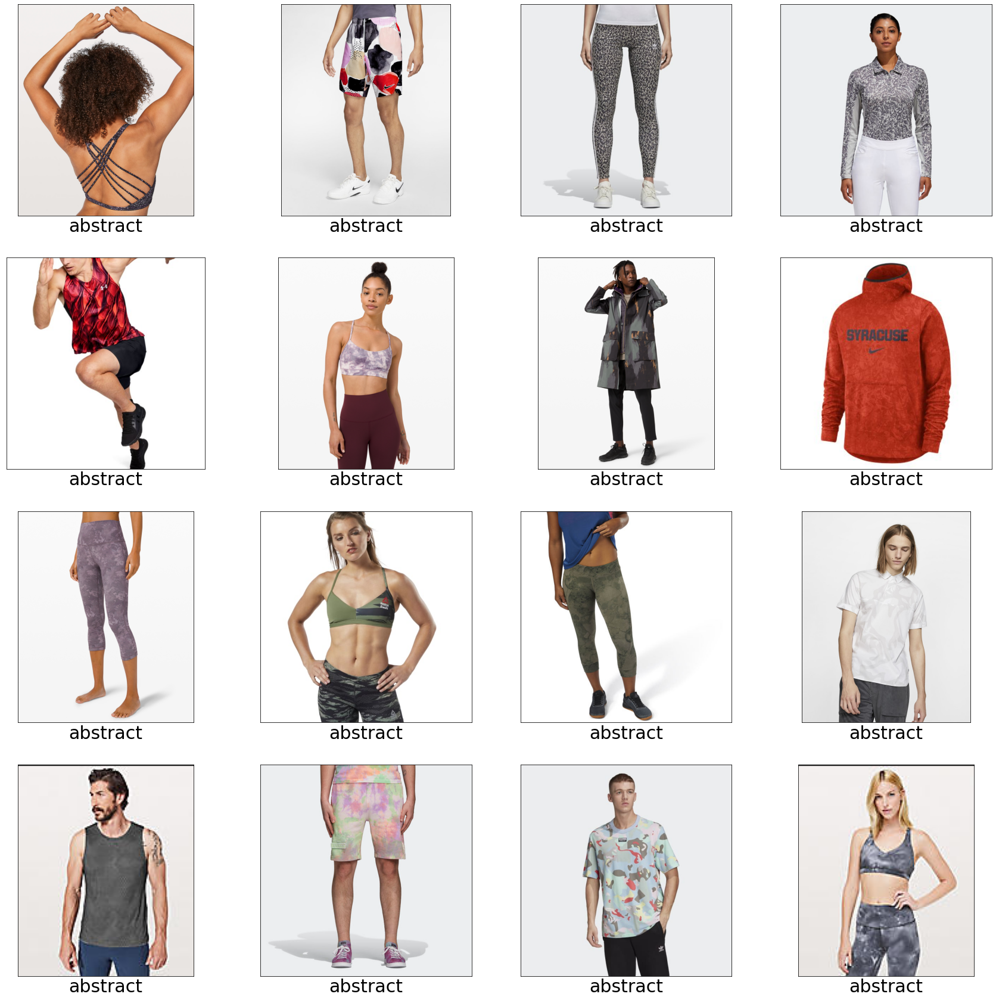







以下是 animal print 類別的圖片


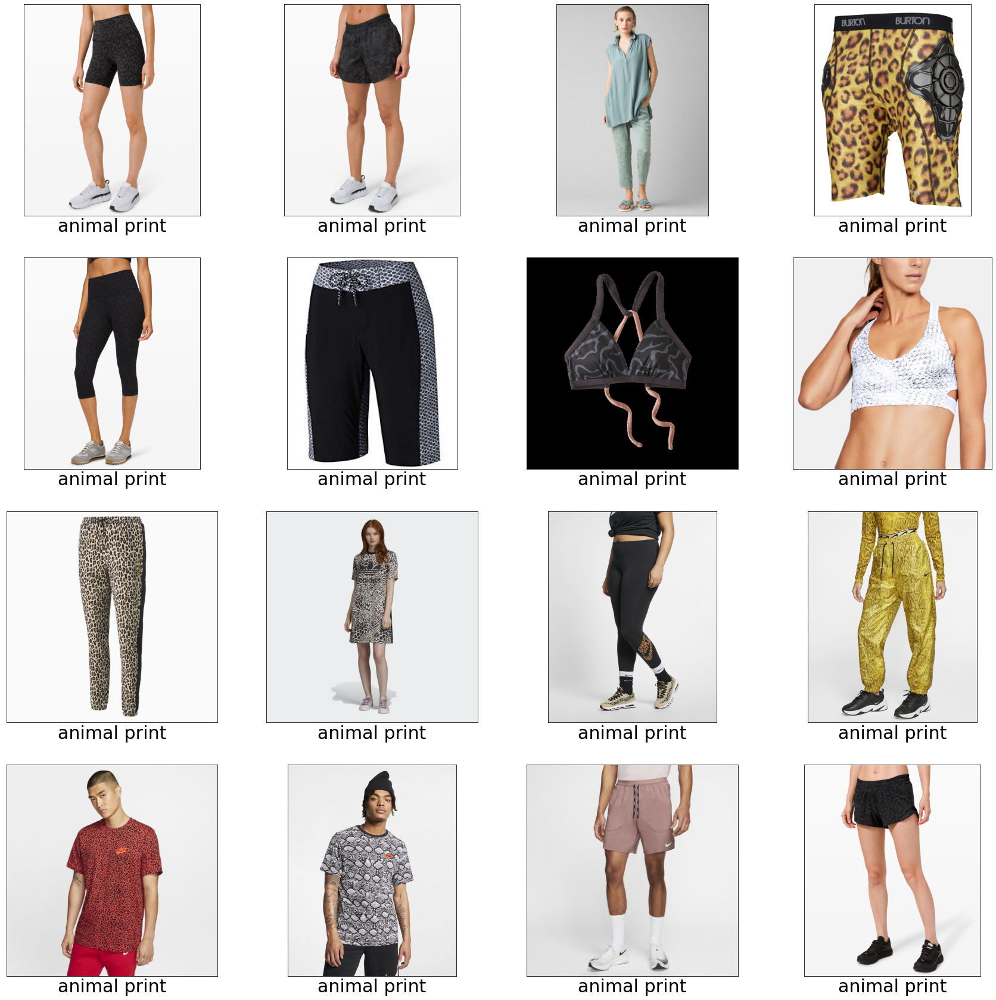







以下是 camouflage 類別的圖片


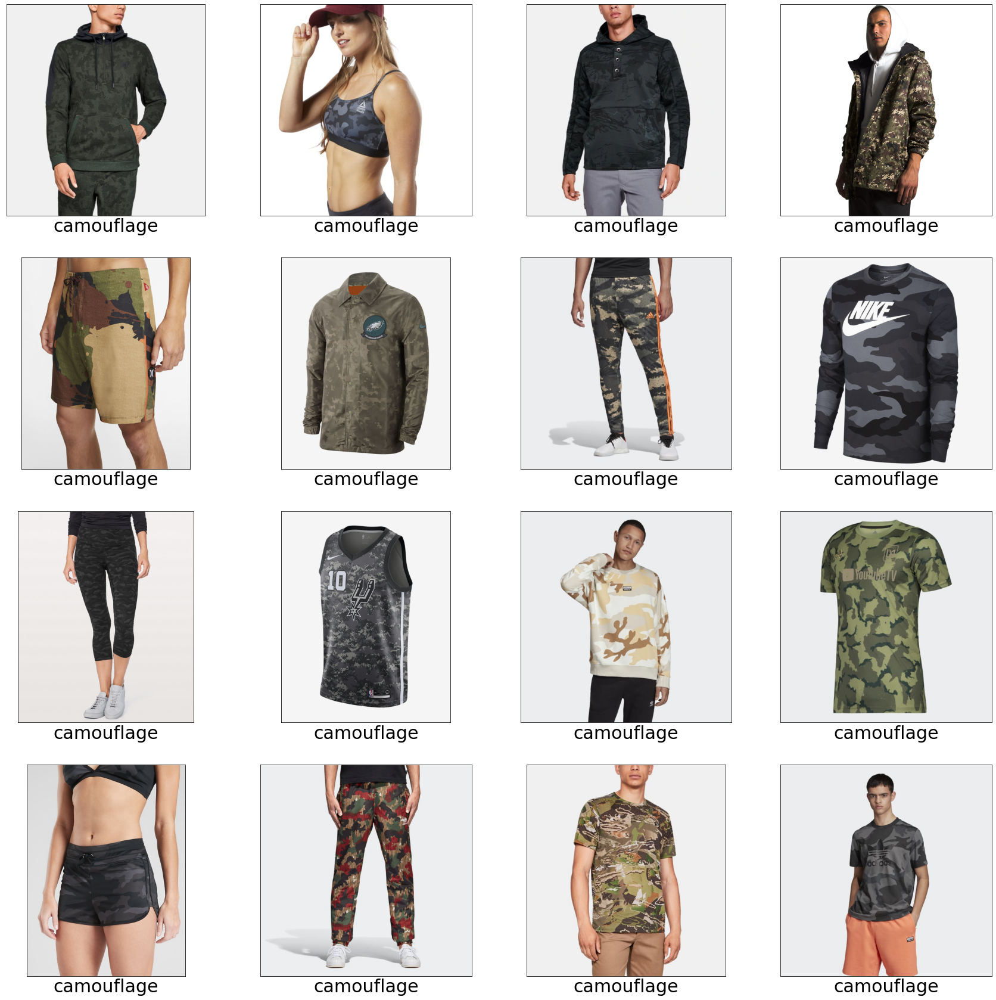







以下是 floral 類別的圖片


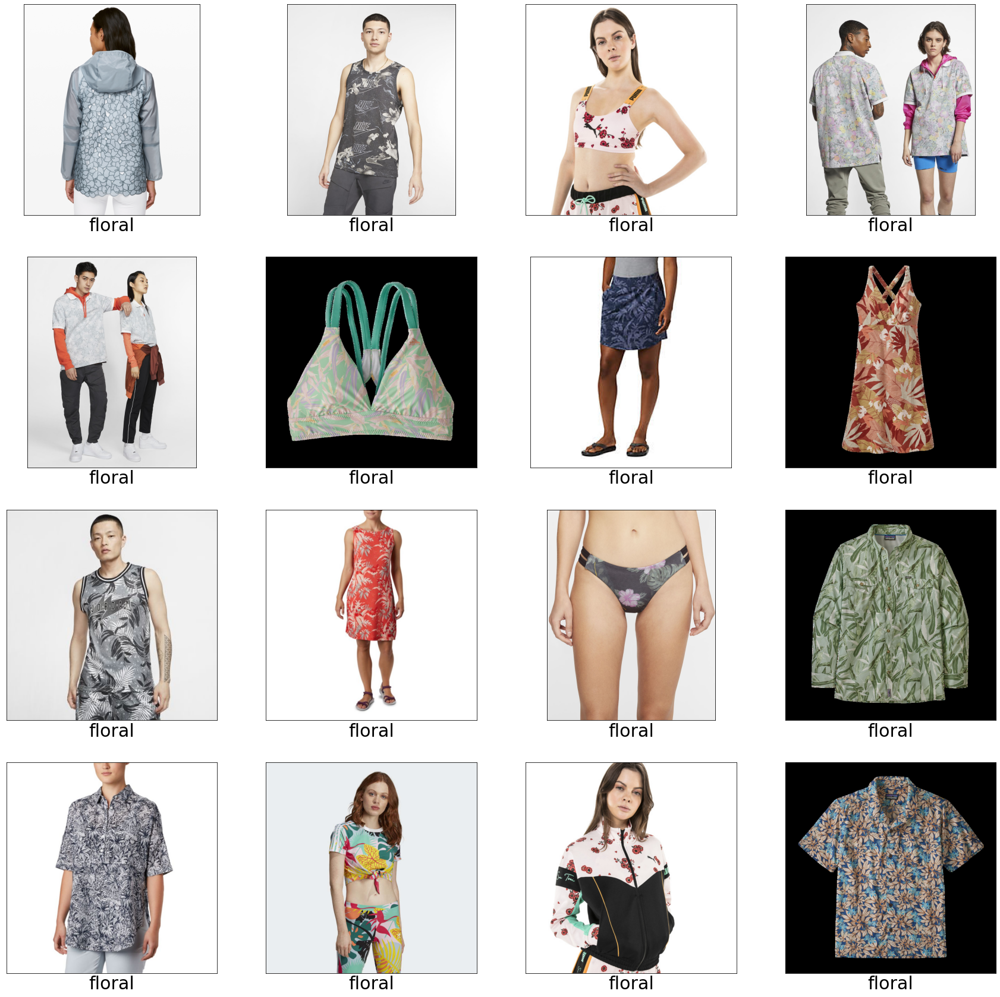







以下是 geometric 類別的圖片


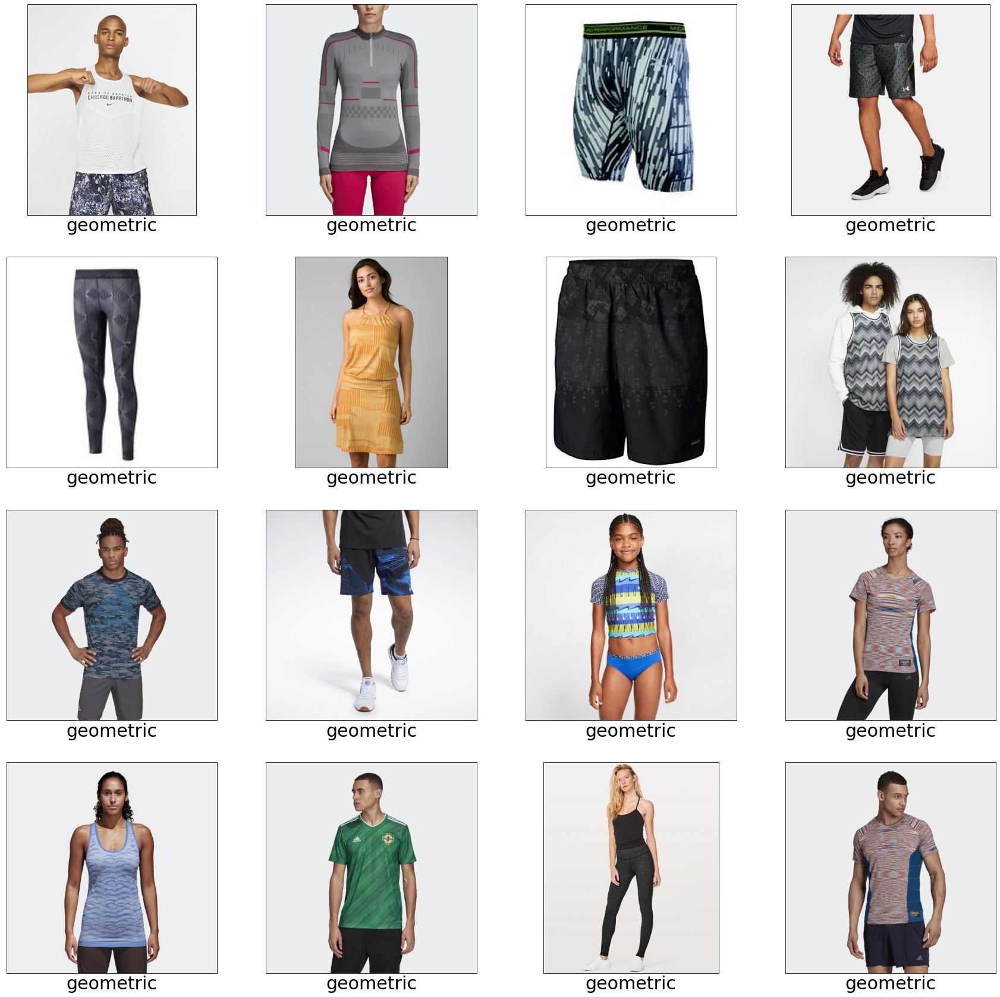







以下是 ikat 類別的圖片


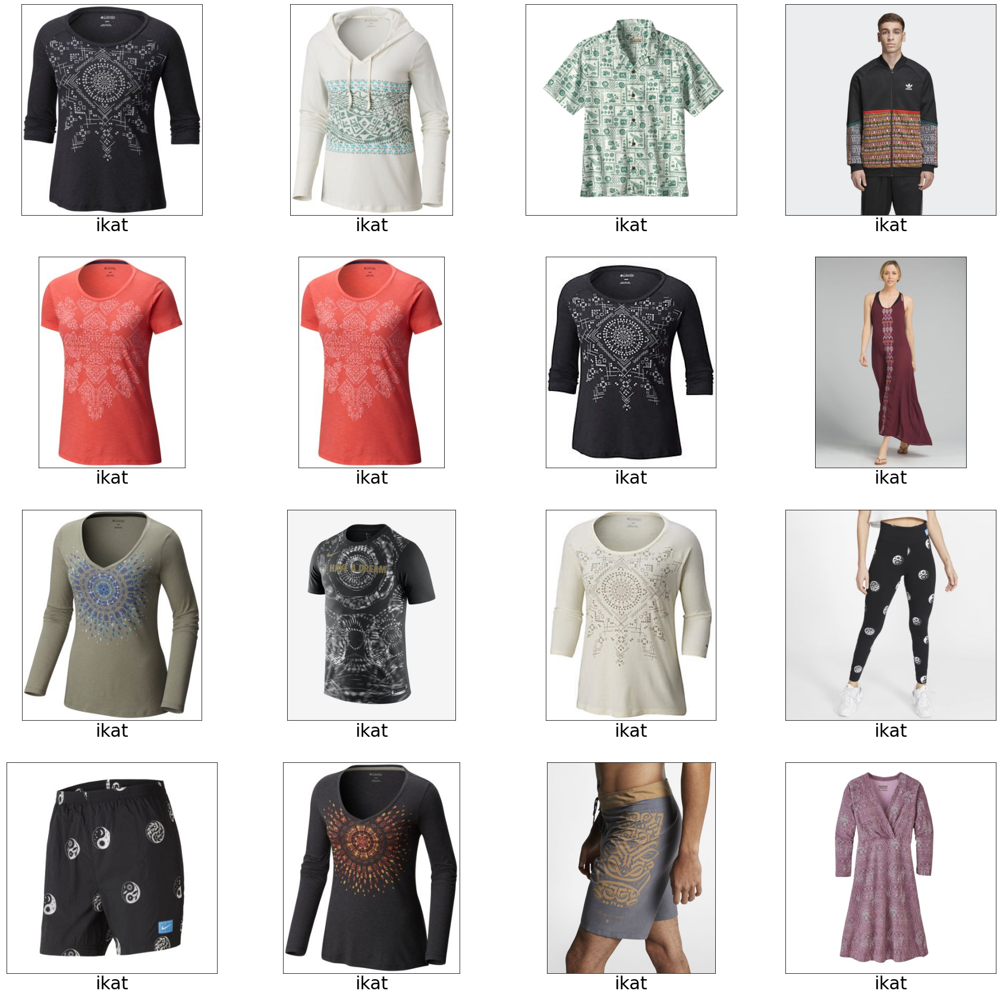







以下是 melange 類別的圖片


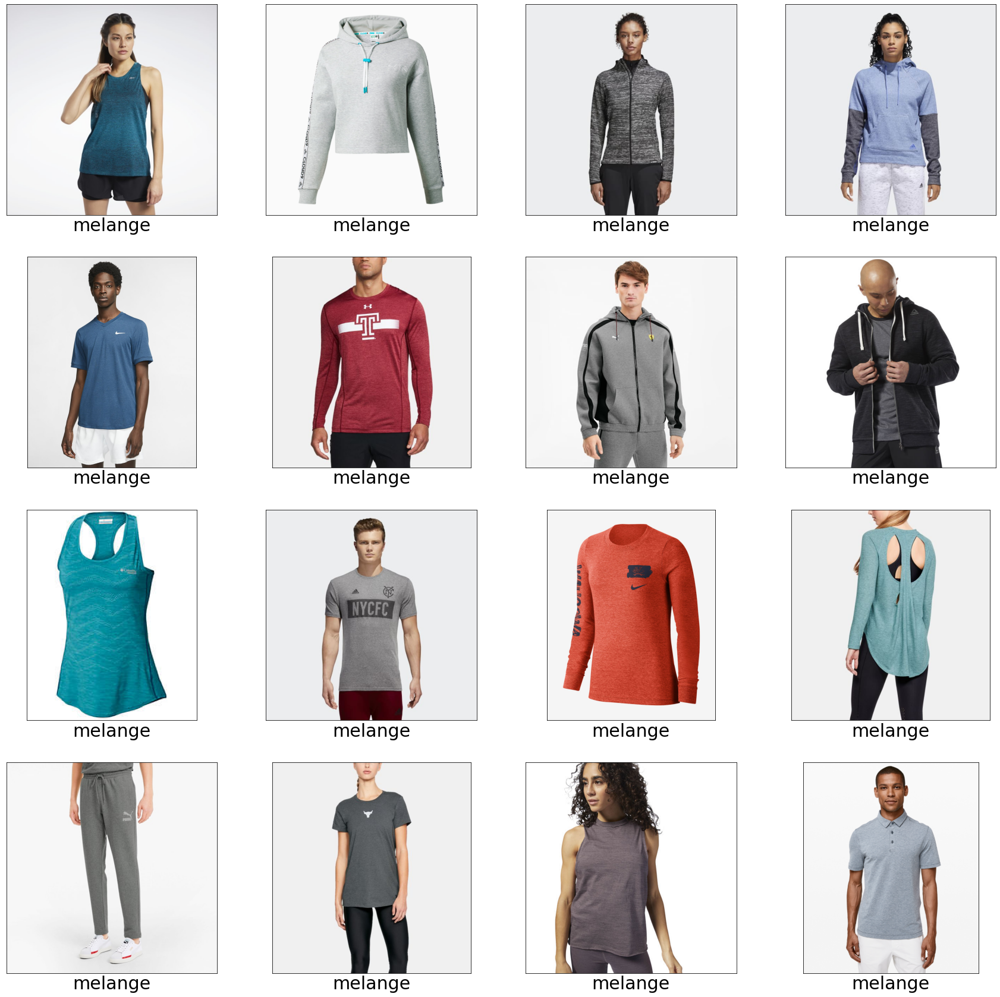







以下是 placement 類別的圖片


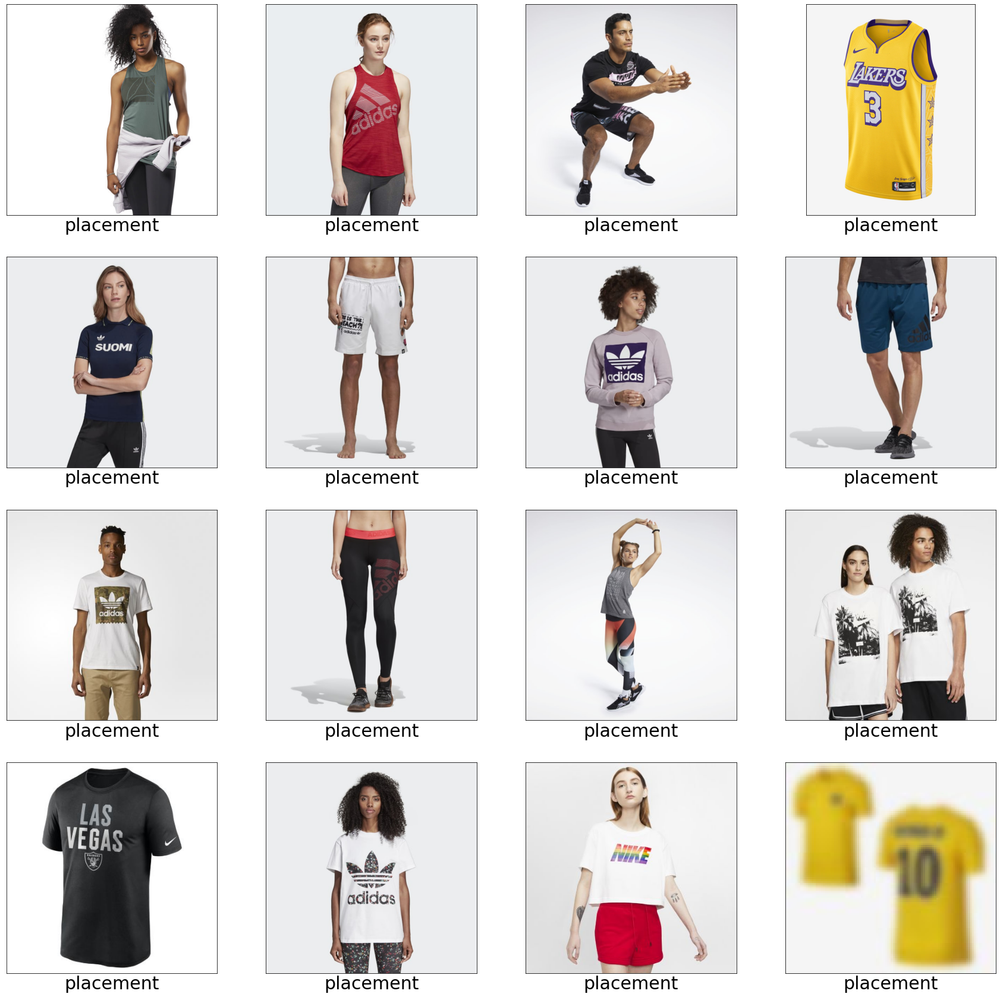







以下是 plaids 類別的圖片


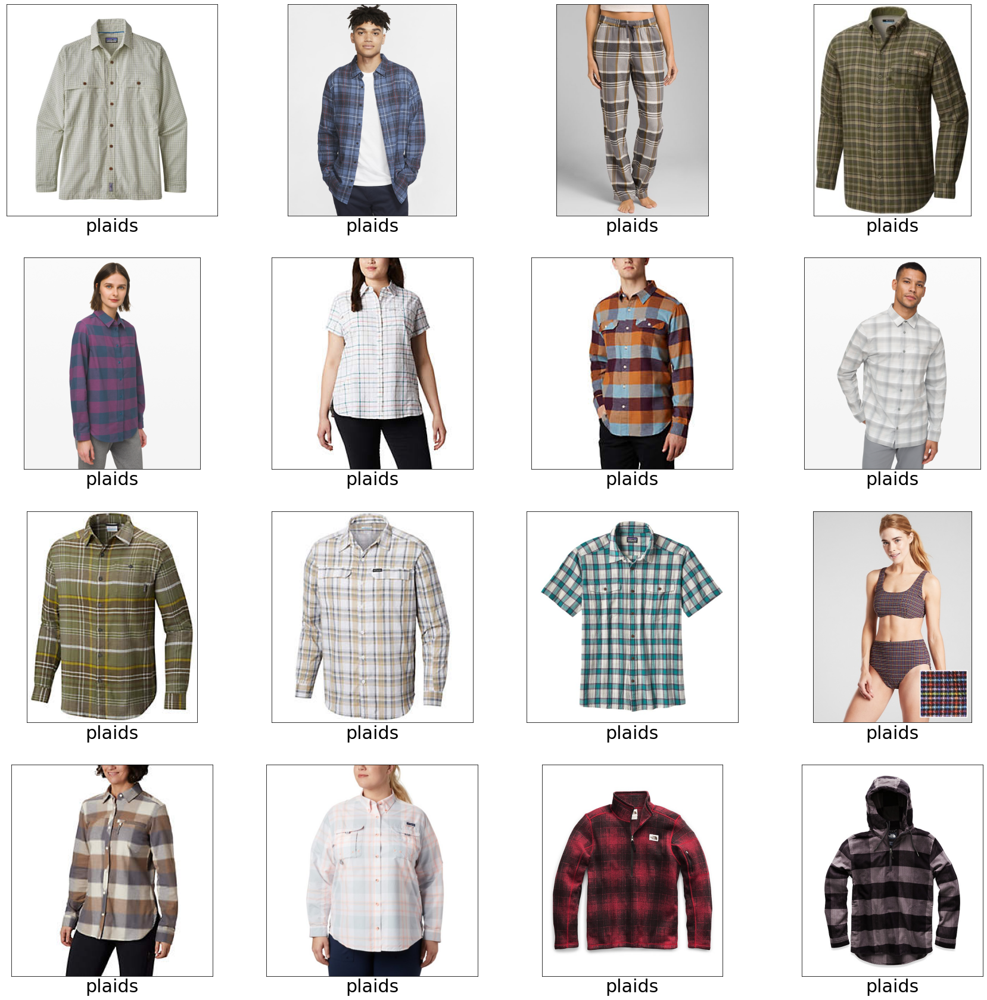







以下是 solid 類別的圖片


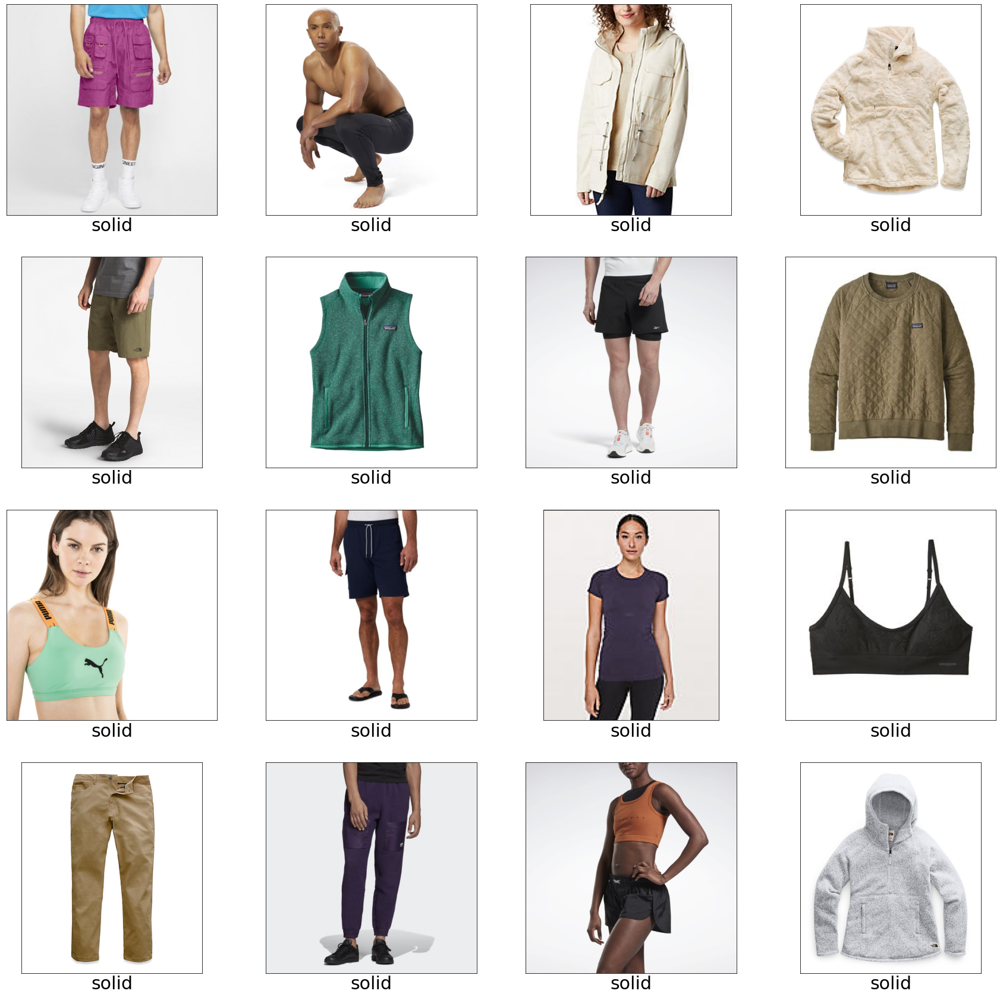







以下是 spots 類別的圖片


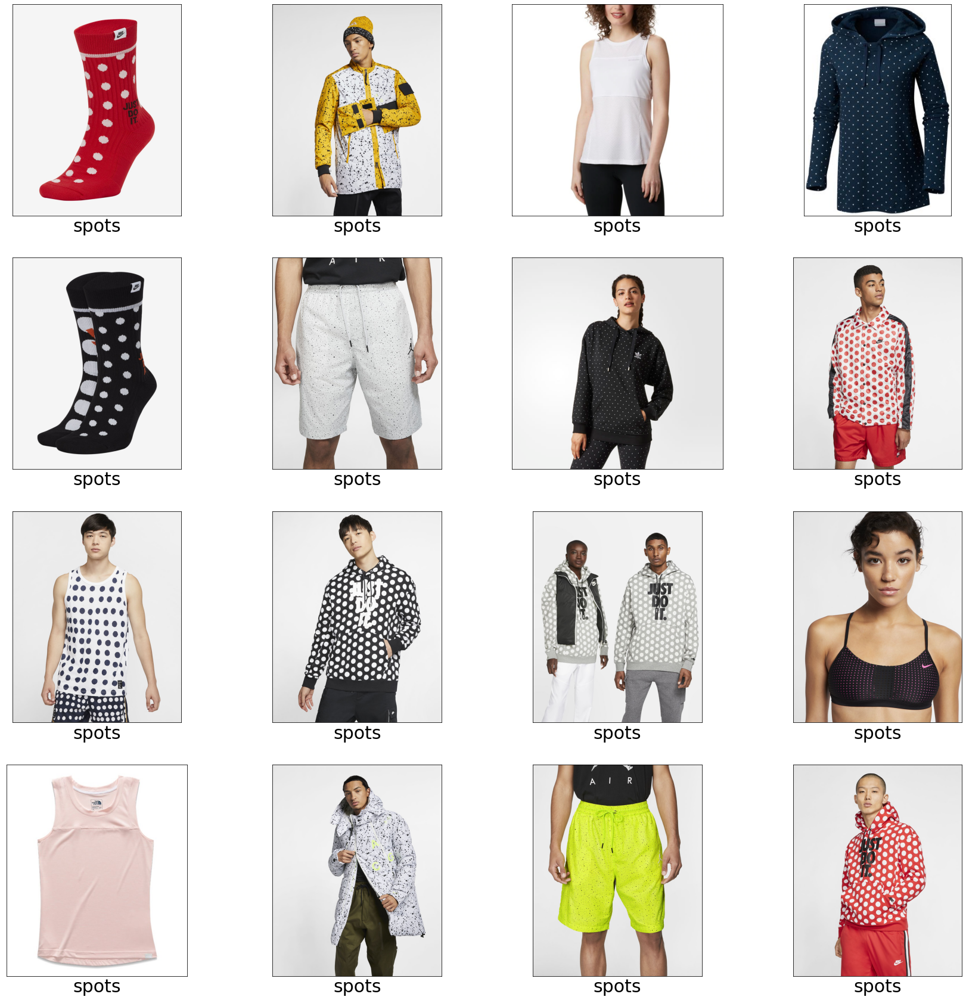







以下是 strips 類別的圖片


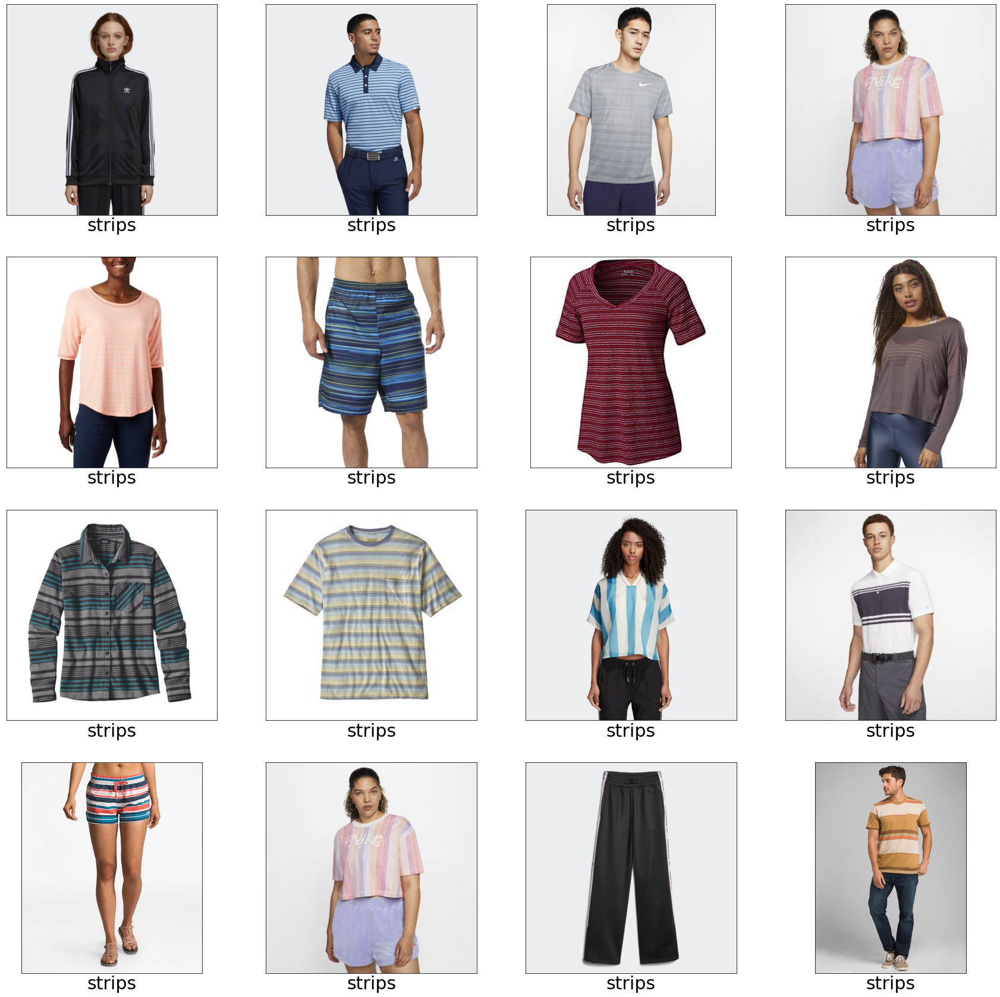

In [16]:
def url_to_image_original(url, width=200, height=200):
    resp = urllib.request.urlopen(url)
    image = np.asarray(bytearray(resp.read()), dtype="uint8")
    image = cv2.imdecode(image, cv2.IMREAD_COLOR) 
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
#     image = cv2.resize(image, (width, height))  # resize
    return image

pattern_list = ["abstract", "animal print", "camouflage", "floral", "geometric", "ikat", "melange", "placement", "plaids", "solid", "spots", "strips"]
for pattern in pattern_list:
# 兩個兩個的大圖版
#     current_pattern = pattern
#     cur_images_index = batch1_url_df.index[batch1_url_df['pattern']==current_pattern].tolist()
#     randomlist = random.sample(cur_images_index, 16)
#     print("\n")
#     print("\n")
#     print("\n")
#     print("以下是 %s 類別的圖片" % (current_pattern,))
#     plt.figure(figsize=(30,120))
#     for i in range(16):
#         plt.subplot(8,2,i+1)
#         plt.xticks([])
#         plt.yticks([])
#         plt.grid(False)
#         plt.imshow(url_to_image_original(batch1_url_df.loc[randomlist[i], 'image_url']), cmap=plt.cm.binary)
#         plt.xlabel(batch1_url_df.loc[randomlist[i], 'pattern'], fontsize=30)
#     plt.show()

    current_pattern = pattern
    cur_images_index = batch1_url_df.index[batch1_url_df['pattern']==current_pattern].tolist()
    randomlist = random.sample(cur_images_index, 16)
    print("\n")
    print("\n")
    print("\n")
    print("以下是 %s 類別的圖片" % (current_pattern,))
    plt.figure(figsize=(30,30))
    for i in range(16):
        plt.subplot(4,4,i+1)
        plt.xticks([])
        plt.yticks([])
        plt.grid(False)
        plt.imshow(url_to_image_original(batch1_url_df.loc[randomlist[i], 'image_url']), cmap=plt.cm.binary)
        plt.xlabel(batch1_url_df.loc[randomlist[i], 'pattern'], fontsize=30)
    plt.show()